In [35]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import requests
from io import BytesIO

Shape de la imagen: (3838, 2161, 3).
Columnas (Ancho): 2161
Filas (Altura): 3838
Canales: 3
Tipo de dato del array: uint8


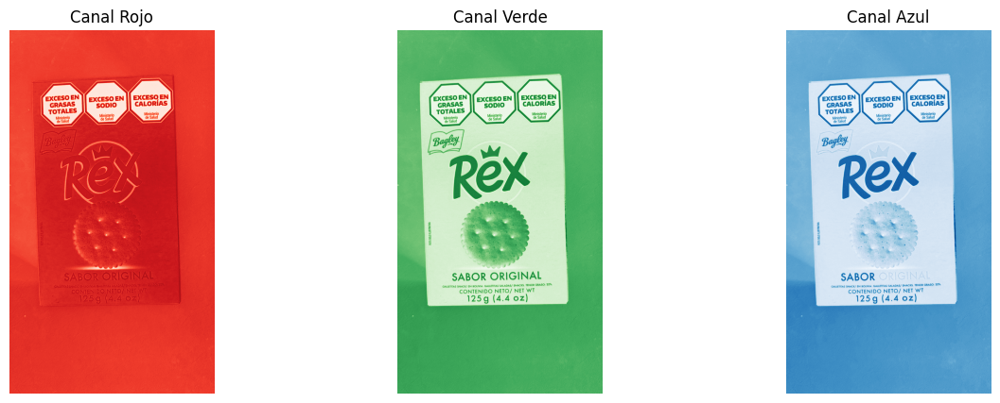

In [36]:


"""# Función auxiliar para leer una imagen desde una URL con OpenCV
def read_image_from_url(url):
    response = requests.get(url)
    image = np.array(bytearray(response.content), dtype=np.uint8)
    image = cv2.imdecode(image, cv2.IMREAD_COLOR)  # Convertir bytes a imagen
    return image"""

# URL de la imagen que deseas descargar
image_url = "https://raw.githubusercontent.com/jpmanson/tuia-unr/main/images/big_buck_bunny.jpg"

# Leer la imagen
image = imagen = cv2.imread('/home/user/Desktop/CV/CV/unidad_1/rex.jpeg')

# OpenCV maneja imágenes en formato BGR, convertir a RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Mostramos la información de la imagen
print(f"Shape de la imagen: {image_rgb.shape}.")
print(f"Columnas (Ancho): {image_rgb.shape[1]}")
print(f"Filas (Altura): {image_rgb.shape[0]}")
print(f"Canales: {image_rgb.shape[2]}")
print(f"Tipo de dato del array: {image_rgb.dtype}")

# Descomponer la imagen en los canales R, G, B
R, G, B = image_rgb[:,:,0], image_rgb[:,:,1], image_rgb[:,:,2]

# Mostrar cada canal de color
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(R, cmap='Reds')
axs[0].set_title('Canal Rojo')
axs[0].axis('off')

axs[1].imshow(G, cmap='Greens')
axs[1].set_title('Canal Verde')
axs[1].axis('off')

axs[2].imshow(B, cmap='Blues')
axs[2].set_title('Canal Azul')
axs[2].axis('off')

plt.show()

Shape de la imagen original (RGB): (3838, 2161, 3)
Tipo de dato del array de la imagen original: uint8
Shape de la imagen en escala de grises: (3838, 2161)
Tipo de dato del array de la imagen en escala de grises: uint8


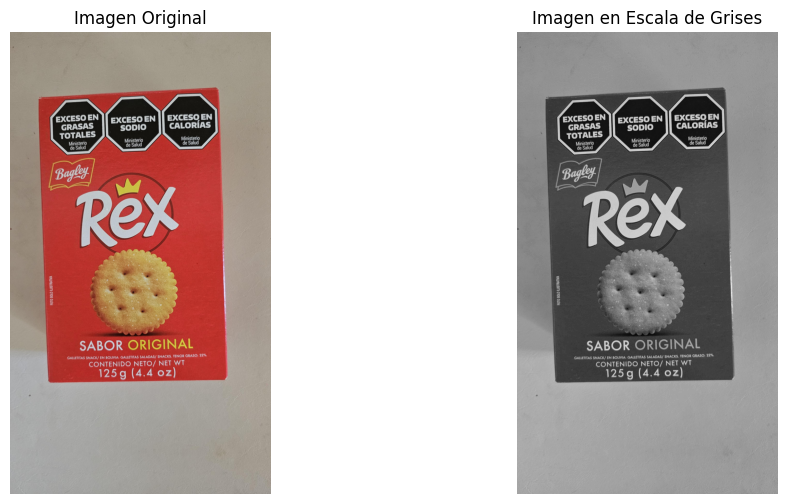

In [37]:


# Convertir la imagen a escala de grises
image_gray = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2GRAY)

# Imprimir el shape y el tipo de dato del array de la imagen original y en escala de grises
print(f"Shape de la imagen original (RGB): {image_rgb.shape}")
print(f"Tipo de dato del array de la imagen original: {image_rgb.dtype}")
print(f"Shape de la imagen en escala de grises: {image_gray.shape}")
print(f"Tipo de dato del array de la imagen en escala de grises: {image_gray.dtype}")

# Mostrar ambas imágenes, original y en escala de grises
plt.figure(figsize=(12, 6))

# Imagen original
plt.subplot(1, 2, 1)
plt.imshow(image_rgb)
plt.title("Imagen Original")
plt.axis('off')

# Imagen en escala de grises
plt.subplot(1, 2, 2)
plt.imshow(image_gray, cmap='gray')
plt.title("Imagen en Escala de Grises")
plt.axis('off')

plt.show()

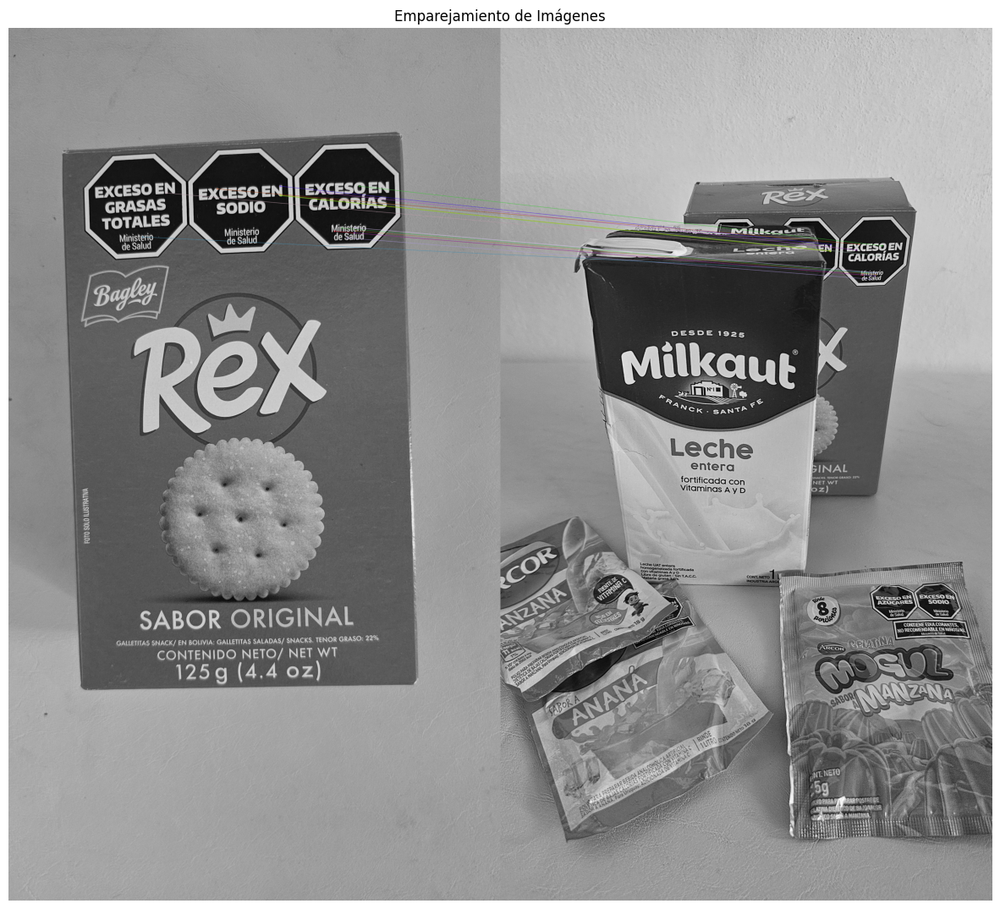

In [38]:
"""!wget "https://mywowo.net/media/images/cache/barcellona_parc_guell_02_visita_jpg_1200_630_cover_85.jpg" -O salamandra1.jpg
!wget "https://i.pinimg.com/originals/a4/57/c5/a457c577a58f3715ce1b53d2b76993c9.jpg" -O salamandra2.jpg"""



# Cargar las imágenes
image1 = cv2.imread('/home/user/Desktop/CV/CV/unidad_1/rex.jpeg', cv2.IMREAD_GRAYSCALE)  # Reemplaza con la ruta a tu imagen
image2 = cv2.imread('/home/user/Desktop/CV/CV/unidad_1/rex_tapada.jpeg', cv2.IMREAD_GRAYSCALE)  # Reemplaza con la ruta a otra imagen

# Inicializar ORB
orb = cv2.ORB_create()

# Detectar keypoints y calcular descriptores
keypoints1, descriptors1 = orb.detectAndCompute(image1, None)
keypoints2, descriptors2 = orb.detectAndCompute(image2, None)

# Crear un objeto BFMatcher para encontrar las coincidencias
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# Encontrar coincidencias
matches = bf.match(descriptors1, descriptors2)

# Ordenar las coincidencias en orden de distancia (cuanto más baja, mejor)
matches = sorted(matches, key=lambda x:x.distance)

# Dibujar las primeras 15 coincidencias
matched_img = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches[:15], outImg=None, flags=2)

# Ajustar el tamaño de la figura de matplotlib
plt.figure(figsize=(15, 20))
plt.imshow(cv2.cvtColor(matched_img, cv2.COLOR_BGR2RGB))
plt.title('Emparejamiento de Imágenes')
plt.axis('off')
plt.show()

In [39]:
import cv2 as cv

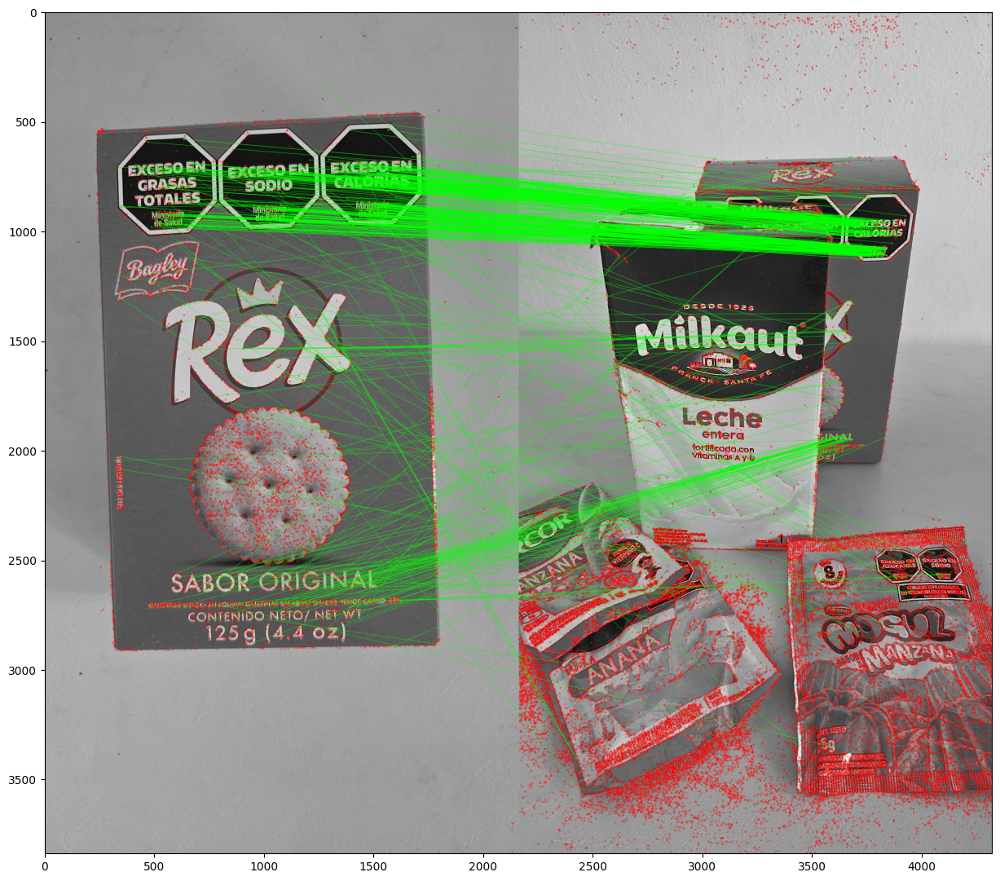

(<matplotlib.image.AxesImage at 0x75be9d804950>, None)

In [40]:

img1 = cv.imread('/home/user/Desktop/CV/CV/unidad_1/rex.jpeg', cv.IMREAD_GRAYSCALE)          # Imagen de consulta (queryImage)
img2 = cv.imread('/home/user/Desktop/CV/CV/unidad_1/rex_tapada.jpeg', cv.IMREAD_GRAYSCALE) # Imagen de entrenamiento (trainImage)

# Iniciar el detector SIFT
sift = cv.SIFT_create()

# Encontrar los keypoints y descriptores con SIFT
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

# Parámetros FLANN
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)  # o pasar un diccionario vacío

# Iniciar FLANN matcher
flann = cv.FlannBasedMatcher(index_params, search_params)

# Realizar emparejamientos kNN
matches = flann.knnMatch(des1, des2, k=2)

# Necesitamos dibujar solo los buenos emparejamientos, por lo que creamos una máscara
matchesMask = [[0, 0] for i in range(len(matches))]

# Test de proporción según el artículo de Lowe (https://www.robots.ox.ac.uk/~vgg/research/affine/det_eval_files/lowe_ijcv2004.pdf)
for i, (m, n) in enumerate(matches):
    if m.distance < 0.7 * n.distance:
        matchesMask[i] = [1, 0]

# Parámetros de dibujo para los emparejamientos
draw_params = dict(matchColor=(0, 255, 0),  # color de los emparejamientos
                   singlePointColor=(255, 0, 0),  # color de los puntos individuales
                   matchesMask=matchesMask,  # máscara para seleccionar emparejamientos
                   flags=cv.DrawMatchesFlags_DEFAULT)

# Dibujar los emparejamientos kNN
img3 = cv.drawMatchesKnn(img1, kp1, img2, kp2, matches, None, **draw_params)
plt.figure(figsize=(15, 20))
# Mostrar la imagen resultante
plt.imshow(img3), plt.show()

Descargamos el video de youtube

In [41]:

from pytube import YouTube




In [42]:
# URL del video de YouTube que deseas descargar
url = "https://www.youtube.com/watch?v=XXdPNnS_XAA"

yt = YouTube(url)

# Seleccionamos la mejor calidad disponible para descargar
video = yt.streams.filter(progressive=True, file_extension="mp4", res="720p").first()

output_filename = "highway.mp4"
video.download(output_filename)

print("Descarga completada.")


Descarga completada.


In [43]:
!ffmpeg -y -i /home/user/Desktop/CV/CV/unidad_1/autos.mp4 -vf "scale=600:-1" -an -t 30 autos_600.mp4

ffmpeg version 6.0-6ubuntu1 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-2ubuntu1)
  configuration: --prefix=/usr --extra-version=6ubuntu1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librist --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtheora --enable-libtwolame --enable-libvidstab --en

In [44]:

import mediapy as media


In [45]:
url = "autos_600.mp4"
video = media.read_video(url)
media.show_video(video)


In [46]:

# Función para oscurecer una imagen:
def process_image(new_image, prev_image, **kwargs):
    # Convertir la imagen a float32
    new_image_float = new_image.astype(np.float32)

    # Reducir el brillo de la imagen a la mitad
    new_image_float *= 0.5

    # Convertir la imagen de vuelta a uint8
    new_image_uint8 = np.clip(new_image_float, 0, 255).astype(np.uint8)

    return new_image_uint8

def draw_contours(frame, contours, color=(0, 255, 0), thickness=2):
    # Comprobar si la imagen es en escala de grises (1 canal)
    if len(frame.shape) == 2 or frame.shape[2] == 1:
        # Convertir la imagen de escala de grises a color (3 canales)
        result_image = cv2.cvtColor(frame, cv2.COLOR_GRAY2BGR)
    else:
        # Si ya es una imagen de color, simplemente hacer una copia
        result_image = frame.copy()

    # Dibujar cada contorno en la imagen
    for contour in contours:
        # Obtener el rectángulo delimitador para cada contorno
        x, y, w, h = cv2.boundingRect(contour)
        # Dibujar el rectángulo
        cv2.rectangle(result_image, (x, y), (x + w, y + h), color, thickness)

    return result_image

# Función para procesar un video:
def video_processor(filename_in, filename_out, process_func, max_time=10, **kwargs):
    # Abrir el video de entrada para lectura
    with media.VideoReader(filename_in) as r:
        # Crear un archivo de video de salida
        with media.VideoWriter(filename_out, shape=r.shape, fps=r.fps, bps=r.bps) as w:
            count = 0  # Inicializar contador de fotogramas
            prev_image = None  # Inicializar la imagen previa

            # Iterar sobre cada imagen (fotograma) del video
            for image in r:
                new_image = media.to_uint8(image)  # Convertir la imagen a formato flotante

                # Comprobar si es la primera imagen
                if prev_image is None:
                    prev_image = new_image.copy()

                # Procesar la imagen utilizando la función dada
                processed_image = process_func(new_image, prev_image, **kwargs)

                # Añadir la imagen procesada al video de salida
                w.add_image(processed_image)

                # Actualizar la imagen previa
                prev_image = new_image.copy()

                # Incrementar el contador de fotogramas
                count += 1

                # Detener el proceso si se alcanza el tiempo máximo
                if count >= max_time * r.fps:
                    break

# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/autos_600.mp4'
filename_out = 'highway_dark.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_image, 10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)




In [50]:
# Función actualizada para realizar diferencia de fotogramas con normalización:
def process_frame_difference(new_image, prev_image, **kwargs):
    # Convertir las imágenes a escala de grises
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_RGB2GRAY)
    prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_RGB2GRAY)

    # Calcular la diferencia absoluta entre los fotogramas actual y anterior
    frame_diff = cv2.absdiff(new_gray, prev_gray)

    # Normalizar la imagen de diferencia
    norm_diff = cv2.normalize(frame_diff, None, 0, 255, cv2.NORM_MINMAX)

    # Umbralizar la imagen para resaltar las diferencias
    _, thresh = cv2.threshold(norm_diff, 30, 255, cv2.THRESH_BINARY)

    # Convertir la imagen umbralizada a color para mantener la consistencia con el video original
    thresh_color = cv2.cvtColor(thresh, cv2.COLOR_GRAY2RGB)

    return thresh_color

# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/autos_600.mp4'
filename_out = 'highway_frame_difference.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_frame_difference, 10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

"\n# Nombres de los archivos de video de entrada y salida\nfilename_in = '/home/user/Desktop/CV/CV/unidad_1/autos_600.mp4'\nfilename_out = 'highway_frame_difference.mp4'\n\n# Llamar a la función para procesar el video\nvideo_processor(filename_in, filename_out, process_frame_difference, 10)\n\n# Mostrar el video resultante\nmedia.show_video(media.read_video(filename_out), fps=30)"

In [17]:
# Función actualizada para detectar movimientos y dibujar cuadros delimitadores:
def process_frame_difference_full(new_image, prev_image, **kwargs):
    # Convertir las imágenes a escala de grises
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_RGB2GRAY)
    prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_RGB2GRAY)

    # Calcular la diferencia absoluta entre los fotogramas actual y anterior
    frame_diff = cv2.absdiff(new_gray, prev_gray)

    # Normalizar la imagen de diferencia
    norm_diff = cv2.normalize(frame_diff, None, 0, 255, cv2.NORM_MINMAX)

    # Umbralizar la imagen para resaltar las diferencias
    _, thresh = cv2.threshold(norm_diff, 30, 255, cv2.THRESH_BINARY)

    # Dilatar la imagen umbralizada para mejorar la detección de contornos
    kernel = np.ones((5,5),np.uint8)
    dilated = cv2.dilate(thresh, kernel, iterations = 1)

    # Convertir la imagen dilatada a formato adecuado para findContours
    dilated = dilated.astype(np.uint8)

    # Encontrar contornos en la imagen dilatada
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Dibujar cuadros delimitadores alrededor de los contornos
    if kwargs.get('draw_mode', 0) == 0:
      result_image = draw_contours(new_image, contours)
    elif kwargs.get('draw_mode', 0) == 1:
      result_image = draw_contours(thresh, contours)

    return result_image


# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/autos_600.mp4'
filename_out = 'highway_frame_difference_full.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_frame_difference_full,
                max_time=10, draw_mode=1)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

# Llamar a la función para procesar el video
filename_out = 'highway_frame_difference_full_2.mp4'
video_processor(filename_in, filename_out, process_frame_difference_full,
                max_time=10, draw_mode=0)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

In [18]:
def process_sparse_optical_flow(new_image, prev_image):
    # Preparamos las imagenes de trabajo
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
    prev_gray_image = cv2.cvtColor(prev_image, cv2.COLOR_BGR2GRAY)

    # Verificar si ya se han detectado las características de Shi-Tomasi
    if not hasattr(process_sparse_optical_flow, "shi_tomasi_done"):
        # Definir parámetros para la detección de esquinas de Shi-Tomasi
        feature_params = dict(maxCorners=300, qualityLevel=0.2, minDistance=2, blockSize=7)
        # Detectar puntos característicos en la imagen
        process_sparse_optical_flow.prev_points = cv2.goodFeaturesToTrack(new_gray, mask=None, **feature_params)
        # Crear una máscara para dibujar el flujo óptico
        process_sparse_optical_flow.mask = np.zeros_like(new_image)
        # Marcar que se ha completado la detección de Shi-Tomasi
        process_sparse_optical_flow.shi_tomasi_done = True

    # Continuar si se ha completado la detección de Shi-Tomasi
    if process_sparse_optical_flow.shi_tomasi_done:
        prev_points = process_sparse_optical_flow.prev_points
        mask = process_sparse_optical_flow.mask

    # Parámetros para el flujo óptico de Lucas-Kanade
    lk_params = dict(winSize=(15, 15), maxLevel=2,
                     criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

    # Calcular el flujo óptico de Lucas-Kanade
    new_points, status, error = cv2.calcOpticalFlowPyrLK(prev_gray_image, new_gray, prev_points, None, **lk_params)
    # Filtrar puntos buenos
    good_old = prev_points[status == 1]
    good_new = new_points[status == 1]
    color = (0, 255, 0)  # Color para el dibujo
    # Dibujar el movimiento (flujo óptico)
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.astype(int).ravel()
        c, d = old.astype(int).ravel()
        mask = cv2.line(mask, (a, b), (c, d), color, 2)
        new_image_umat = cv2.UMat(new_image)
        new_image_umat = cv2.circle(new_image_umat, (a, b), 3, color, -1)
        new_image = new_image_umat.get()

    # Combinar la imagen actual con las líneas de flujo óptico dibujadas
    output = cv2.add(new_image, mask)
    # Actualizar puntos para el siguiente cuadro
    process_sparse_optical_flow.prev_points = good_new.reshape(-1, 1, 2)
    return output

# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/autos.mp4'
filename_out = 'highway_process_sparse_optical_flow.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_sparse_optical_flow,
                max_time=10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

In [19]:
# Función para procesar el flujo óptico denso
def process_dense_optical_flow(new_image, prev_image):
    # Convierte la nueva imagen a escala de grises
    gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)

    if not hasattr(process_dense_optical_flow, "init_done"):
        process_dense_optical_flow.prev_gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
        process_dense_optical_flow.mask = np.zeros_like(new_image)
        process_dense_optical_flow.mask[..., 1] = 255
        process_dense_optical_flow.init_done = True

    if process_dense_optical_flow.init_done:
        prev_gray = process_dense_optical_flow.prev_gray
        mask = process_dense_optical_flow.mask

    # Calcula el flujo óptico
    flow = cv2.calcOpticalFlowFarneback(prev_gray, gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
    # Computa magnitud y ángulo de los vectores 2D
    magnitude, angle = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    # Establece el tono de la imagen según la dirección del flujo óptico
    mask[..., 0] = angle * 180 / np.pi / 2
    # Establece el valor de la imagen según la magnitud del flujo óptico
    mask[..., 2] = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX)
    # Convierte de HSV a RGB
    rgb = cv2.cvtColor(mask, cv2.COLOR_HSV2BGR)
    # Actualiza la imagen previa a gris
    process_dense_optical_flow.prev_grayprev_gray = gray.copy()
    return rgb

# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/autos_600.mp4'
filename_out = 'highway_process_dense_optical_flow.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_dense_optical_flow,
                max_time=20)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

In [20]:
#Background Subtraction
def process_back_sub(new_image, prev_image, **kwargs):
  # Inicializar el sustractor de fondo si aún no se ha hecho
  if not hasattr(process_back_sub, 'init_done'):
    # Obtener el método de sustracción de fondo especificado
    method = kwargs.get('method', 'MOG')
    match method:
      case 'CNT':
          process_back_sub.back_method = cv2.bgsegm.createBackgroundSubtractorCNT()
      case 'GMG':
          process_back_sub.back_method = cv2.bgsegm.createBackgroundSubtractorGMG()
      case 'GSOC':
          process_back_sub.back_method = cv2.bgsegm.createBackgroundSubtractorGSOC()
      case 'LSBP':
          process_back_sub.back_method = cv2.bgsegm.createBackgroundSubtractorLSBP()
      case 'KNN':
          process_back_sub.back_method = cv2.createBackgroundSubtractorKNN()
      case 'MOG' | 'MOG2':
          process_back_sub.back_method = cv2.createBackgroundSubtractorMOG2(detectShadows=kwargs.get('detect_shadows', True))
      case _:
          print(f'Método {method} no implementado')
    process_back_sub.init_done = True

  # Aplicar el método de sustracción de fondo seleccionado a la nueva imagen
  back_method = process_back_sub.back_method
  foreground_mask = back_method.apply(new_image)

  # Umbralizar la máscara para resaltar los objetos en movimiento
  _, thresh = cv2.threshold(foreground_mask, kwargs.get('threshold_val', 30), 255, cv2.THRESH_BINARY)

  # Aplicar erosión y dilatación para mejorar la segmentación
  kernel_size = kwargs.get('kernel_size', 5)
  kernel = np.ones((kernel_size, kernel_size), np.uint8)
  thresh = cv2.erode(thresh, kernel, iterations=kwargs.get('erode_iterations', 1))
  thresh = cv2.dilate(thresh, kernel, iterations=kwargs.get('dilate_iterations', 1))

  # Encontrar contornos
  contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  # Determinar qué imagen se usará para dibujar los contornos
  match result_frame:
    case 'mask':
        result_image = cv2.cvtColor(foreground_mask, cv2.COLOR_GRAY2BGR)
    case 'morph':
        result_image = cv2.cvtColor(thresh, cv2.COLOR_GRAY2BGR)
    case _:  # original
      result_image = new_image

  # Dibujar cuadros delimitadores (bounding boxes)
  show_boxes = kwargs.get('show_boxes', True)
  if show_boxes:
    for contour in contours:
        if cv2.contourArea(contour) > kwargs.get('min_area', 100):
            x, y, w, h = cv2.boundingRect(contour)
            result_image = cv2.rectangle(result_image, (x, y), (x+w, y+h), (0, 255, 0), 2)

  return result_image

# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/autos_600.mp4'
result_frame = 'morph'   # Opciones: 'mask', 'morph', 'original'
for method in ['MOG', 'CNT', 'GMG', 'GSOC', 'LSBP', 'KNN']:
  filename_out = f'highway_background_subtraction_{method}.mp4'

  # Llamar a la función para procesar el video
  video_processor(filename_in, filename_out, process_back_sub,
                  max_time=10, method=method, result_frame=result_frame)

  # Mostrar el video resultante
  print(f'Método {method}:')
  media.show_video(media.read_video(filename_out), fps=30)

Método MOG:


Método CNT:


Método GMG:


Método GSOC:


Método LSBP:


Método KNN:


In [28]:
!ffmpeg -y -i /home/user/Desktop/CV/CV/unidad_1/persona.mp4 -vf "scale=600:ih*2/2" -an -t 25 persona_600.mp4


ffmpeg version 6.0-6ubuntu1 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-2ubuntu1)
  configuration: --prefix=/usr --extra-version=6ubuntu1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librist --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtheora --enable-libtwolame --enable-libvidstab --en

In [29]:
url = "persona_600.mp4"
video = media.read_video(url)
media.show_video(video)

In [53]:

# Función para oscurecer una imagen:
def process_image(new_image, prev_image, **kwargs):
    # Convertir la imagen a float32
    new_image_float = new_image.astype(np.float32)

    # Reducir el brillo de la imagen a la mitad
    new_image_float *= 0.75

    # Convertir la imagen de vuelta a uint8
    new_image_uint8 = np.clip(new_image_float, 0, 255).astype(np.uint8)

    return new_image_uint8

def draw_contours(frame, contours, color=(0, 255, 0), thickness=2):
    # Comprobar si la imagen es en escala de grises (1 canal)
    if len(frame.shape) == 2 or frame.shape[2] == 1:
        # Convertir la imagen de escala de grises a color (3 canales)
        result_image = cv2.cvtColor(frame, cv2.COLOR_GRAY2BGR)
    else:
        # Si ya es una imagen de color, simplemente hacer una copia
        result_image = frame.copy()

    # Dibujar cada contorno en la imagen
    for contour in contours:
        # Obtener el rectángulo delimitador para cada contorno
        x, y, w, h = cv2.boundingRect(contour)
        # Dibujar el rectángulo
        cv2.rectangle(result_image, (x, y), (x + w, y + h), color, thickness)

    return result_image

# Función para procesar un video:
def video_processor(filename_in, filename_out, process_func, max_time=10, **kwargs):
    # Abrir el video de entrada para lectura
    with media.VideoReader(filename_in) as r:
        # Crear un archivo de video de salida
        with media.VideoWriter(filename_out, shape=r.shape, fps=r.fps, bps=r.bps) as w:
            count = 0  # Inicializar contador de fotogramas
            prev_image = None  # Inicializar la imagen previa

            # Iterar sobre cada imagen (fotograma) del video
            for image in r:
                new_image = media.to_uint8(image)  # Convertir la imagen a formato flotante

                # Comprobar si es la primera imagen
                if prev_image is None:
                    prev_image = new_image.copy()

                # Procesar la imagen utilizando la función dada
                processed_image = process_func(new_image, prev_image, **kwargs)

                # Añadir la imagen procesada al video de salida
                w.add_image(processed_image)

                # Actualizar la imagen previa
                prev_image = new_image.copy()

                # Incrementar el contador de fotogramas
                count += 1

                # Detener el proceso si se alcanza el tiempo máximo
                if count >= max_time * r.fps:
                    break

# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/persona_600.mp4'
filename_out = 'persona_dark.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_image, 25)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

In [56]:
"""# Función actualizada para detectar movimientos y dibujar cuadros delimitadores:
def process_frame_difference_full(new_image, prev_image, **kwargs):
    # Convertir las imágenes a escala de grises
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_RGB2GRAY)
    prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_RGB2GRAY)

    # Calcular la diferencia absoluta entre los fotogramas actual y anterior
    frame_diff = cv2.absdiff(new_gray, prev_gray)

    # Normalizar la imagen de diferencia
    norm_diff = cv2.normalize(frame_diff, None, 0, 255, cv2.NORM_MINMAX)

    # Umbralizar la imagen para resaltar las diferencias
    _, thresh = cv2.threshold(norm_diff, 10, 255, cv2.THRESH_BINARY)

    # Dilatar la imagen umbralizada para mejorar la detección de contornos
    kernel = np.ones((5,5),np.uint8)
    dilated = cv2.dilate(thresh, kernel, iterations = 1)

    # Convertir la imagen dilatada a formato adecuado para findContours
    dilated = dilated.astype(np.uint8)

    # Encontrar contornos en la imagen dilatada
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
      
    # Dibujar cuadros delimitadores alrededor de los contornos
    if kwargs.get('draw_mode', 0) == 0:
      result_image = draw_contours(new_image, contours)
    elif kwargs.get('draw_mode', 0) == 1:
      result_image = draw_contours(thresh, contours)

    return result_image"""

import numpy as np

def process_frame_difference_full(new_image, prev_image, **kwargs):
    # Convertir las imágenes a escala de grises
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_RGB2GRAY)
    prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_RGB2GRAY)

    # Calcular la diferencia absoluta entre los fotogramas actual y anterior
    frame_diff = cv2.absdiff(new_gray, prev_gray)

    # Normalizar la imagen de diferencia
    norm_diff = cv2.normalize(frame_diff, None, 0, 255, cv2.NORM_MINMAX)

    # Aplicar umbral adaptativo
    thresh = cv2.adaptiveThreshold(norm_diff, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

    # Dilatar la imagen umbralizada para mejorar la detección de contornos
    kernel = np.ones((5,5),np.uint8)
    dilated = cv2.dilate(thresh, kernel, iterations = 1)

    # Convertir la imagen dilatada a formato adecuado para findContours
    dilated = dilated.astype(np.uint8)

    # Encontrar contornos en la imagen dilatada
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
      
    # Filtrar contornos por tamaño
    min_area = kwargs.get('min_area', 1000)
    max_area = kwargs.get('max_area', 100000)
    filtered_contours = [cnt for cnt in contours if min_area < cv2.contourArea(cnt) < max_area]

    # Dibujar cuadros delimitadores alrededor de los contornos
    if kwargs.get('draw_mode', 0) == 0:
      result_image = draw_contours(new_image, filtered_contours)
    elif kwargs.get('draw_mode', 0) == 1:
      result_image = draw_contours(thresh, filtered_contours)

    return result_image


# Nombres de los archivos de video de entrada y salida
filename_in = '/home/user/Desktop/CV/CV/unidad_1/persona_dark.mp4'
filename_out = 'persona_frame_difference_full.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_frame_difference_full,
                max_time=20, draw_mode=1)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

# Llamar a la función para procesar el video
filename_out = 'highway_frame_difference_full_2.mp4'
video_processor(filename_in, filename_out, process_frame_difference_full,
                max_time=20, draw_mode=0)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

KeyboardInterrupt: 